# This file was adopted from Planetary Computer tutorial.
[Adjusting for the Sentinel-2 Baseline Change](https://planetarycomputer.microsoft.com/dataset/sentinel-2-l2a#Baseline-Change)


## Adjusting for the Sentinel-2 Baseline Change

On January 25th, 2022 the European Space Agency implemented a [change to the processing baseline](https://sentinels.copernicus.eu/web/sentinel/-/copernicus-sentinel-2-major-products-upgrade-upcoming) for Sentinel-2 data that affects both L1C and the L2A data hosted by the Planetary Computer.

The crux of the change is an offset to the L1C image reflectance data, which propagates to the L2A data hosted by the Planetary Computer.

As explained by ESA:

> This evolution allows avoiding the loss of information due to clamping of negative values in the predefined range `[1-32767]` occurring over dark surfaces.

The presence of this offset in newer data makes it inappropriate to (naively) compare data from before and after the baseline change. Trying to apply a machine learning model trained on the old baseline to (unadjusted) imagery from the new baseline will yield incorrect results. And trying to train a machine learning model on old and (unadjusted) new data will likely result in much worse performance.

This notebook demonstrates how the change affects the Sentinel-2 L2A data hosted on the Planetary Computer and how to harmonize the new data to be comparable to the old data.

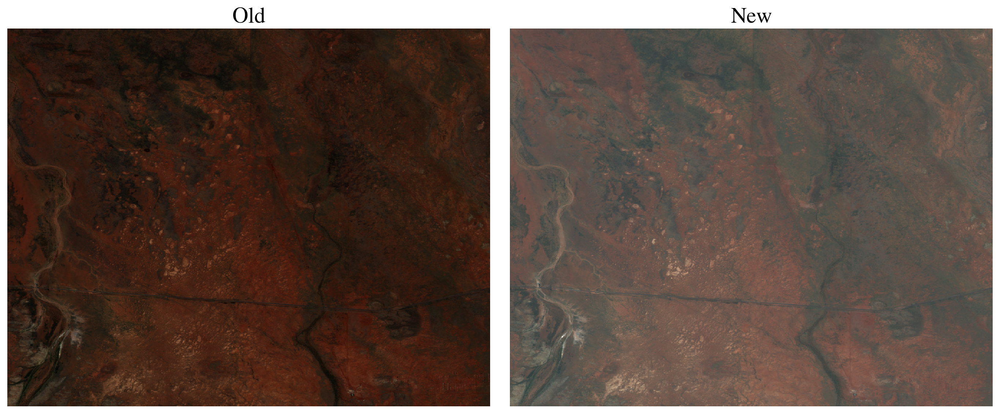

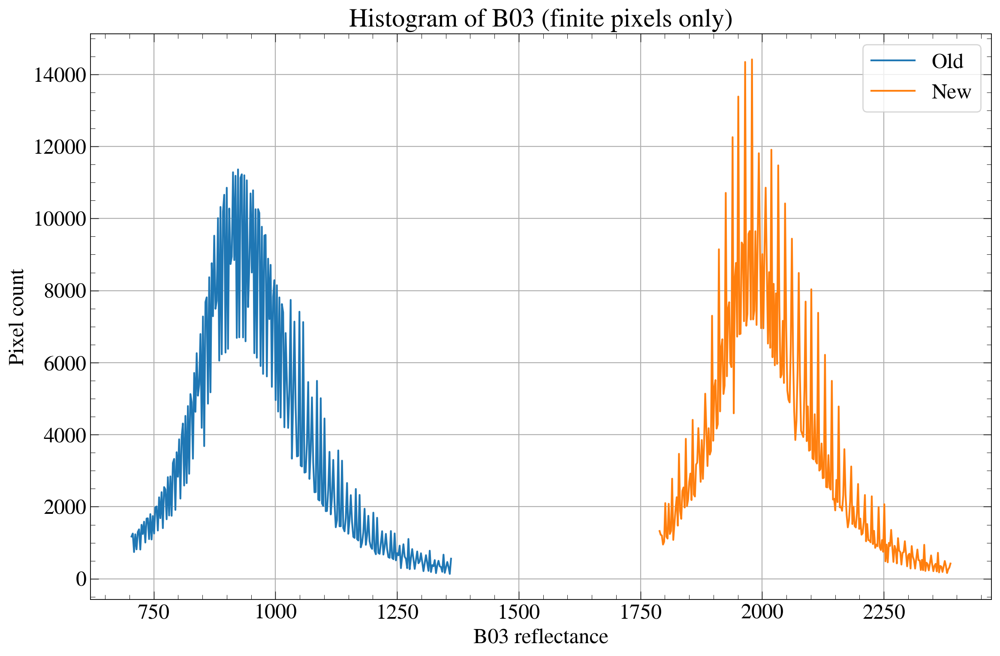

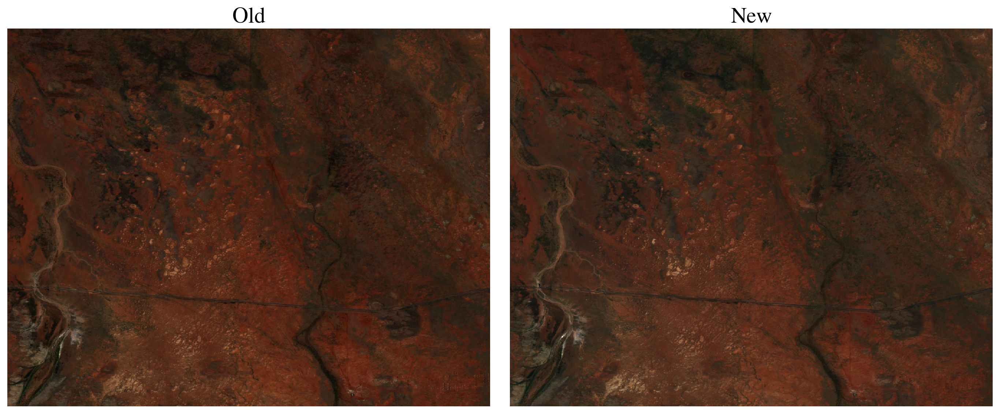

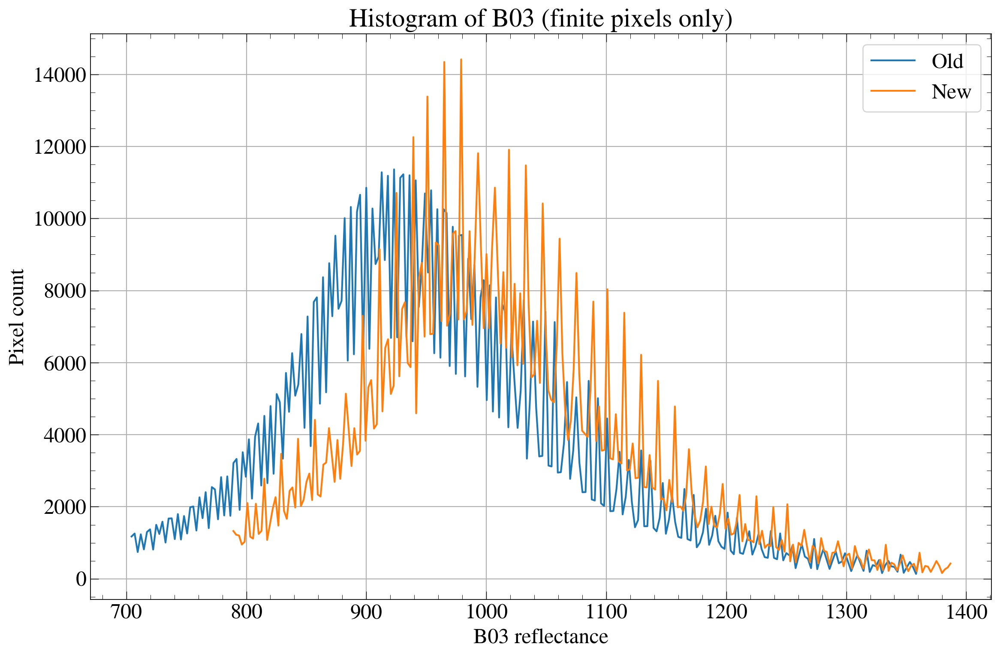

In [1]:
import datetime
import stackstac
import numpy as np
import xarray as xr
import pystac_client
import seaborn as sns  # if you want sns.despine()
import rasterio as rio
import skimage.exposure
import geopandas as gpd
import planetary_computer
from skimage import exposure
import matplotlib.pyplot as plt

plt.style.use("~/geoscience/albedo_downscaling/MNRAS.mplstyle")
%matplotlib inline

def harmonize_to_old(data):
    """
    Harmonize new Sentinel-2 data to the old baseline.

    Parameters
    ----------
    data: xarray.DataArray
        A DataArray with four dimensions: time, band, y, x

    Returns
    -------
    harmonized: xarray.DataArray
        A DataArray with all values harmonized to the old
        processing baseline.
    """
    cutoff = datetime.datetime(2022, 1, 25)
    offset = 1000
    bands = [
        "B01",
        "B02",
        "B03",
        "B04",
        "B05",
        "B06",
        "B07",
        "B08",
        "B8A",
        "B09",
        "B10",
        "B11",
        "B12",
    ]

    old = data.sel(time=slice(cutoff))

    to_process = list(set(bands) & set(data.band.data.tolist()))
    new = data.sel(time=slice(cutoff, None)).drop_sel(band=to_process)

    new_harmonized = data.sel(time=slice(cutoff, None), band=to_process).clip(offset)
    new_harmonized -= offset

    new = xr.concat([new, new_harmonized], "band").sel(band=data.band.data.tolist())
    return xr.concat([old, new], dim="time")

s2 = pystac_client.Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1/",
    modifier=planetary_computer.sign_inplace,
).get_collection("sentinel-2-l2a")

# Default params
old = s2.get_item("S2B_MSIL2A_20220106T021339_R060_T50KPC_20220107T033435")
new = s2.get_item("S2A_MSIL2A_20230116T021341_R060_T50KPC_20230116T112621")

bounds = (600000, 7690240, 610000, 7700240)

assets = ["B02", "B03", "B04", "B05", "B06", "AOT"]
# ds = stackstac.stack([old, new], assets=assets, bounds=bounds)
# ds

with rio.open(old.assets["B02"].href) as src:
    epsg = src.crs.to_epsg()

ds = stackstac.stack(
    [old, new],
    assets=["B02","B03","B04","B05","B06","AOT"],
    epsg=epsg,
    bounds=bounds              # make sure bounds are in that same EPSG
)
ds

fig, axes = plt.subplots(ncols=2, figsize=(14, 6))

# R,G,B = B04,B03,B02
img = ds.sel(band=["B04", "B03", "B02"]).compute()

# # Method 2: If you prefer exact min/max instead of percentiles
vmin_tb = img.min(dim=("time","y","x"), skipna=True)
vmax_tb = img.max(dim=("time","y","x"), skipna=True)

img_s = ((img - vmin_tb) / (vmax_tb - vmin_tb)).clip(0, 1)

img_s.isel(time=0).plot.imshow(rgb="band", ax=axes[0]); axes[0].set(title="Old")
img_s.isel(time=1).plot.imshow(rgb="band", ax=axes[1]); axes[1].set(title="New")
for ax in axes: ax.set_axis_off()
plt.tight_layout(); plt.show()

def plot_hist_one(ax, da, label, nbins=256, q=(2, 98)):
    """
    Plot a 1D histogram of an xarray DataArray on `ax`,
    ignoring NaNs and using a robust [vmin, vmax] from percentiles.
    """
    arr = da.data.compute()
    finite = np.isfinite(arr)
    if not finite.any():
        ax.text(0.5, 0.5, f"{label}: all NaN", ha="center", va="center", transform=ax.transAxes)
        return
    vals = arr[finite]
    if q is not None:
        vmin, vmax = np.quantile(vals, [q[0]/100, q[1]/100])
        if not np.isfinite(vmin) or not np.isfinite(vmax) or vmin == vmax:
            vmin, vmax = np.nanmin(vals), np.nanmax(vals)
    else:
        vmin, vmax = np.nanmin(vals), np.nanmax(vals)

    hist, edges = np.histogram(vals, bins=nbins, range=(vmin, vmax))
    centers = 0.5 * (edges[:-1] + edges[1:])
    ax.plot(centers, hist, label=label)

# --- Select the band you want (avoid positional .isel if band labels exist) ---
# If your bands are labeled "B02","B03","B04", pick by name:
band_name = "B03"        # change to the band you want
da_old = ds.sel(time=ds.time[0], band=band_name)
da_new = ds.sel(time=ds.time[1], band=band_name)

fig, ax = plt.subplots(figsize=(12, 8))
plot_hist_one(ax, da_old, label="Old")
plot_hist_one(ax, da_new, label="New")

ax.set_xlabel(f"{band_name} reflectance")
ax.set_ylabel("Pixel count")
ax.set_title(f"Histogram of {band_name} (finite pixels only)")
ax.legend()
# sns.despine()
plt.tight_layout()
plt.show()


harmonized = harmonize_to_old(ds)


fig, axes = plt.subplots(ncols=2, figsize=(14, 6))

# R,G,B = B04,B03,B02
img = harmonized.sel(band=["B04", "B03", "B02"]).astype("float32").compute()

# # Method 2: If you prefer exact min/max instead of percentiles
vmin_tb = img.min(dim=("time","y","x"), skipna=True)
vmax_tb = img.max(dim=("time","y","x"), skipna=True)

# Rescale to 0–1; NaNs stay NaN (transparent in plot)
img_s = ((img - vmin_tb) / (vmax_tb - vmin_tb)).clip(0, 1)

# Plot two dates
img0 = img_s.isel(time=0)
img1 = img_s.isel(time=1)

if np.isfinite(img0.values).any():
    img0.plot.imshow(rgb="band", ax=axes[0])
    axes[0].set(title="Old")
else:
    axes[0].text(0.5, 0.5, "All NaN", ha="center", va="center"); axes[0].set(title="Old")

if np.isfinite(img1.values).any():
    img1.plot.imshow(rgb="band", ax=axes[1])
    axes[1].set(title="New")
else:
    axes[1].text(0.5, 0.5, "All NaN", ha="center", va="center"); axes[1].set(title="New")

for ax in axes:
    ax.set_axis_off()
plt.tight_layout(); plt.show()

band_name = "B03"  # change as needed

fig, ax = plt.subplots(figsize=(12, 8))

def plot_skimage_hist(ax, da, label, nbins=256, q=(2, 98)):
    vals = da.load().values
    vals = vals[np.isfinite(vals)]
    if vals.size == 0:
        ax.text(0.5, 0.5, f"{label}: all NaN", ha="center", va="center", transform=ax.transAxes)
        return
    # optional robust clipping to avoid extreme outliers
    if q is not None:
        lo, hi = np.percentile(vals, q)
        vals = vals[(vals >= lo) & (vals <= hi)]
    hist, bin_centers = exposure.histogram(vals, nbins=nbins, source_range="image", channel_axis=None)
    ax.plot(bin_centers, hist, label=label)

plot_skimage_hist(ax, harmonized.sel(time=harmonized.time[0], band=band_name), "Old")
plot_skimage_hist(ax, harmonized.sel(time=harmonized.time[1], band=band_name), "New")

ax.set_xlabel(f"{band_name} reflectance")
ax.set_ylabel("Pixel count")
ax.set_title(f"Histogram of {band_name} (finite pixels only)")
ax.legend()
plt.tight_layout(); plt.show()


# An Example Scene From The East River Basin - My Data

The `harmonize_to_old` function harmonizes new (post January 25th, 2022) Sentinel 2 data to be comparable to older data. It expects an xarray DataArray similar to those returned by `stackstac`.

In [2]:
def harmonize_to_old(data):
    """
    Harmonize new Sentinel-2 data to the old baseline.

    Parameters
    ----------
    data: xarray.DataArray
        A DataArray with four dimensions: time, band, y, x

    Returns
    -------
    harmonized: xarray.DataArray
        A DataArray with all values harmonized to the old
        processing baseline.
    """
    cutoff = datetime.datetime(2022, 1, 25)
    offset = 1000
    bands = [
        "B01",
        "B02",
        "B03",
        "B04",
        "B05",
        "B06",
        "B07",
        "B08",
        "B8A",
        "B09",
        "B10",
        "B11",
        "B12",
    ]

    old = data.sel(time=slice(cutoff))

    to_process = list(set(bands) & set(data.band.data.tolist()))
    new = data.sel(time=slice(cutoff, None)).drop_sel(band=to_process)

    new_harmonized = data.sel(time=slice(cutoff, None), band=to_process).clip(offset)
    new_harmonized -= offset

    new = xr.concat([new, new_harmonized], "band").sel(band=data.band.data.tolist())
    return xr.concat([old, new], dim="time")

To demonstrate the problem, we'll load an "old" scene with the old processing baseline of `03.00`, and a "new" scene with a new processing baseline of `04.00`.

In [3]:
# 2022-01-20 vs 2022-02-01

s2 = pystac_client.Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1/",
    modifier=planetary_computer.sign_inplace,
).get_collection("sentinel-2-l2a")

# Default params
# old = s2.get_item("S2B_MSIL2A_20220106T021339_R060_T50KPC_20220107T033435")
# new = s2.get_item("S2A_MSIL2A_20230116T021341_R060_T50KPC_20230116T112621")
# bounds = (600000, 7690240, 610000, 7700240)

# # new params
# old = s2.get_item("S2A_MSIL2A_20211018T175341_R141_T13SCD_20211019T181359")
# new = s2.get_item("S2B_MSIL2A_20221018T175329_R141_T13SCD_20221019T062704")

# Best so far
old = s2.get_item("S2A_MSIL2A_20220116T175701_R141_T13SCD_20220117T024536")
new = s2.get_item("S2B_MSIL2A_20220220T175349_R141_T13SCD_20220226T042621")

# old = s2.get_item("S2A_MSIL2A_20220116T175701_R141_T13SCD_20220117T024536")
# new = s2.get_item("S2B_MSIL2A_20220131T175549_R141_T13SCD_20220216T204716")

shapefile_path = "/bsuhome/tnde/scratch/felix/modis/East_River_SHP/ER_bbox.shp"
# AOI from shapefile (WGS84 for STAC)
Boundary = gpd.read_file(shapefile_path)
Boundary_wgs84 = Boundary.to_crs(epsg=4326)

# bounds tuple (minlon, minlat, maxlon, maxlat)
bounds_latlon = tuple(Boundary_wgs84.total_bounds) # 4-tuple, not a geometry

We'll stack these together, cropping out a small section of the image to speed up loading.

In [4]:
# # Option A: Use bounds if EPSG is UTM
# assets = ["B02", "B03", "B04", "B05", "B06", "AOT"]
# # ds = stackstac.stack([old, new], assets=assets, bounds=bounds)
# # ds

# with rio.open(old.assets["B02"].href) as src:
#     epsg = src.crs.to_epsg()

# ds = stackstac.stack(
#     [old, new],
#     assets=["B02","B03","B04","B05","B06","AOT"],
#     epsg=epsg,
#     bounds=bounds              # make sure bounds are in that same EPSG
# )
# ds

In [5]:
# Option B: Use bounds_latlon if EPSG is UTM
assets = ["B02", "B03", "B04", "B05", "B06", "AOT"]
# ds = stackstac.stack([old, new], assets=assets, bounds=bounds)
# ds

with rio.open(old.assets["B02"].href) as src:
    epsg = src.crs.to_epsg()

ds = stackstac.stack(
    [old, new],
    assets=["B02","B03","B04","B05","B06","AOT"],
    epsg=epsg,
    bounds_latlon=bounds_latlon              # make sure bounds are in that same EPSG
)
ds

<xarray.DataArray 'stackstac-cf0fd6f5cc656312983a97d8ce8723a5' (time: 2,
                                                                band: 6,
                                                                y: 1336, x: 1240)> Size: 159MB
dask.array<fetch_raster_window, shape=(2, 6, 1336, 1240), dtype=float64, chunksize=(1, 1, 1024, 1024), chunktype=numpy.ndarray>
Coordinates: (12/44)
  * time                                     (time) datetime64[ns] 16B 2022-0...
    id                                       (time) <U54 432B 'S2A_MSIL2A_202...
  * band                                     (band) <U3 72B 'B02' ... 'AOT'
  * x                                        (x) float64 10kB 3.222e+05 ... 3...
  * y                                        (y) float64 11kB 4.323e+06 ... 4...
    s2:datatake_id                           (time) <U34 272B 'GS2A_20220116T...
    ...                                       ...
    proj:bbox                                object 8B {300000.0, 4290240.0, ...
    gsd                                      (band) float64 48B 10.0 ... 10.0
    common_name                              (band) object 48B 'blue' ... None
    center_wavelength                        (band) object 48B 0.49 ... None
    full_width_half_max                      (band) object 48B 0.098 ... None
    epsg                                     int64 8B 32613
Attributes:
    spec:           RasterSpec(epsg=32613, bounds=(322223.5026507012, 4308857...
    crs:            epsg:32613
    transform:      | 10.37, 0.00, 322223.50|\n| 0.00,-10.37, 4322713.09|\n| ...
    resolution_xy:  (10.372223738192918, 10.371292159938845)

If we plot the red, green, and blue bands of the two datetimes, we will see that the "old" data looks relatively dark compared to the "new" data.

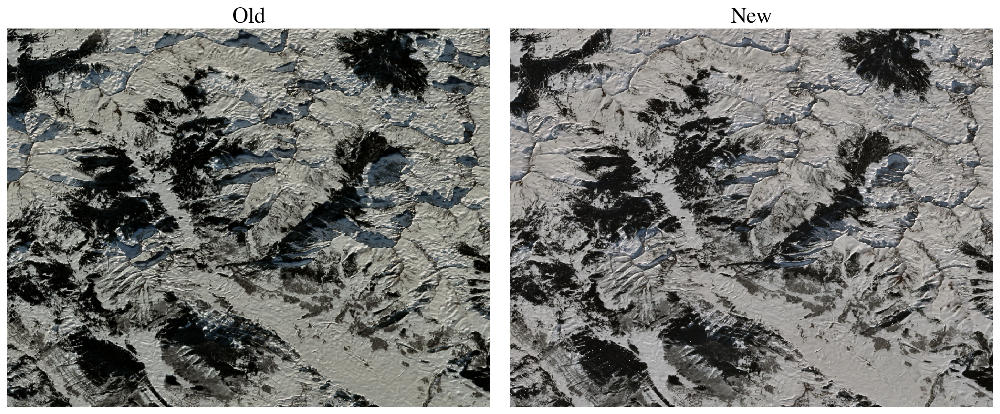

In [6]:
fig, axes = plt.subplots(ncols=2, figsize=(14, 6))

# R,G,B = B04,B03,B02
img = ds.sel(band=["B04", "B03", "B02"]).compute()

# # Option A: robust per-band limits across all times (2–98th percentiles)
# # Method 1: percentiles
# vmin = img.quantile(0.02, dim=("time","y","x"), skipna=True)   # dims: band
# vmax = img.quantile(0.98, dim=("time","y","x"), skipna=True)

# Method 2: If you prefer exact min/max instead of percentiles
vmin = img.min(dim=("time","y","x"), skipna=True)
vmax = img.max(dim=("time","y","x"), skipna=True)

# rescale to 0–1, NaNs stay NaN
img_s = ((img - vmin) / (vmax - vmin)).clip(0, 1)

img_s.isel(time=0).plot.imshow(rgb="band", ax=axes[0]); axes[0].set(title="Old")
img_s.isel(time=1).plot.imshow(rgb="band", ax=axes[1]); axes[1].set(title="New")
for ax in axes: ax.set_axis_off()
plt.tight_layout(); plt.show()

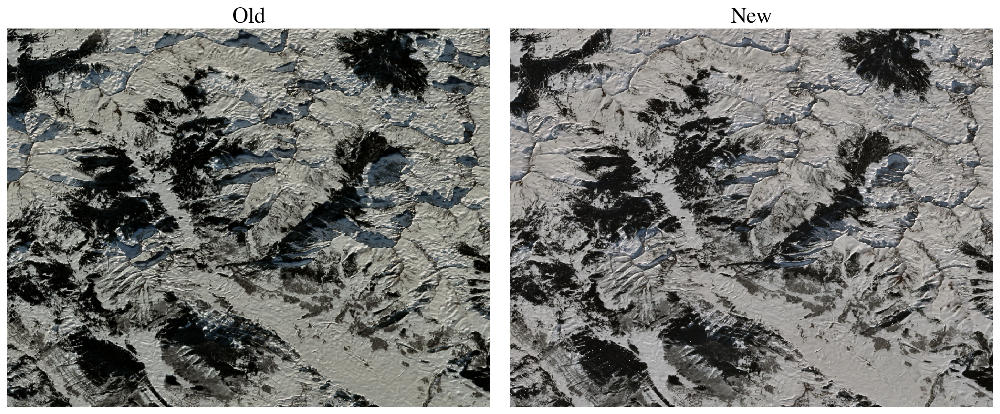

In [7]:
fig, axes = plt.subplots(ncols=2, figsize=(14, 6))

# R,G,B = B04,B03,B02
img = ds.sel(band=["B04", "B03", "B02"]).compute()

# # Option B: robust per-time, per-band limits
# # Method 1: percentiles
# vmin_tb = img.quantile(0.02, dim=("y","x"), skipna=True)  # dims: time, band
# vmax_tb = img.quantile(0.98, dim=("y","x"), skipna=True)

# # Method 2: If you prefer exact min/max instead of percentiles
vmin_tb = img.min(dim=("time","y","x"), skipna=True)
vmax_tb = img.max(dim=("time","y","x"), skipna=True)

img_s = ((img - vmin_tb) / (vmax_tb - vmin_tb)).clip(0, 1)

img_s.isel(time=0).plot.imshow(rgb="band", ax=axes[0]); axes[0].set(title="Old")
img_s.isel(time=1).plot.imshow(rgb="band", ax=axes[1]); axes[1].set(title="New")
for ax in axes: ax.set_axis_off()
plt.tight_layout(); plt.show()

By taking the histogram of, say, the green band, we'll see that the new data are shifted to the right.

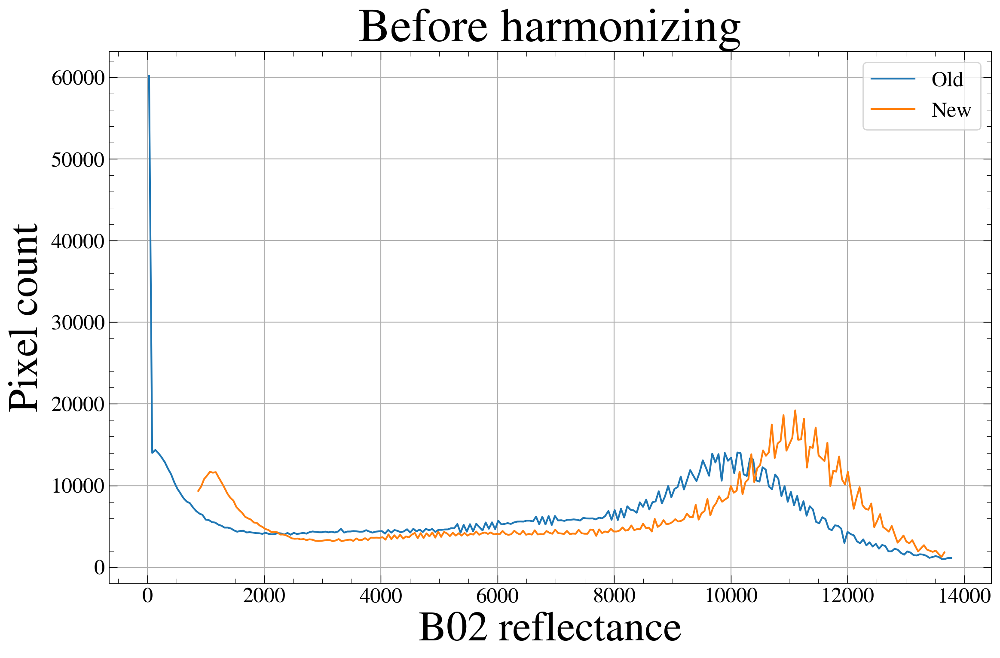

In [8]:
def plot_hist_one(ax, da, label, nbins=256, q=(2, 98)):
    """
    Plot a 1D histogram of an xarray DataArray on `ax`,
    ignoring NaNs and using a robust [vmin, vmax] from percentiles.
    """
    arr = da.data.compute()
    finite = np.isfinite(arr)
    if not finite.any():
        ax.text(0.5, 0.5, f"{label}: all NaN", ha="center", va="center", transform=ax.transAxes)
        return
    vals = arr[finite]
    if q is not None:
        vmin, vmax = np.quantile(vals, [q[0]/100, q[1]/100])
        if not np.isfinite(vmin) or not np.isfinite(vmax) or vmin == vmax:
            vmin, vmax = np.nanmin(vals), np.nanmax(vals)
    else:
        vmin, vmax = np.nanmin(vals), np.nanmax(vals)

    hist, edges = np.histogram(vals, bins=nbins, range=(vmin, vmax))
    centers = 0.5 * (edges[:-1] + edges[1:])
    ax.plot(centers, hist, label=label)

# --- Select the band you want (avoid positional .isel if band labels exist) ---
# If your bands are labeled "B02","B03","B04", pick by name:
band_name = "B02"        # change to the band you want
da_old = ds.sel(time=ds.time[0], band=band_name)
da_new = ds.sel(time=ds.time[1], band=band_name)

fig, ax = plt.subplots(figsize=(12, 8))
plot_hist_one(ax, da_old, label="Old")
plot_hist_one(ax, da_new, label="New")

ax.set_xlabel(f"{band_name} reflectance", fontsize=35)
ax.set_ylabel("Pixel count", fontsize=35)
# ax.set_title(f"Histogram of {band_name}")
ax.set_title(f"Before harmonizing", fontsize=40)
ax.legend()
# sns.despine()
plt.tight_layout()
plt.show()

# vals_old = da_old.data.compute()
# vals_old = vals_old[np.isfinite(vals_old)]
# hist, bins = skimage.exposure.histogram(vals_old)  # now it has a finite range

In [9]:
# skimage.exposure.histogram(vals_old)

Now, let's harmonize data, shifting the new data to make it comparable to the old.

In [10]:
harmonized = harmonize_to_old(ds)

Now the RGB images look much more similar:

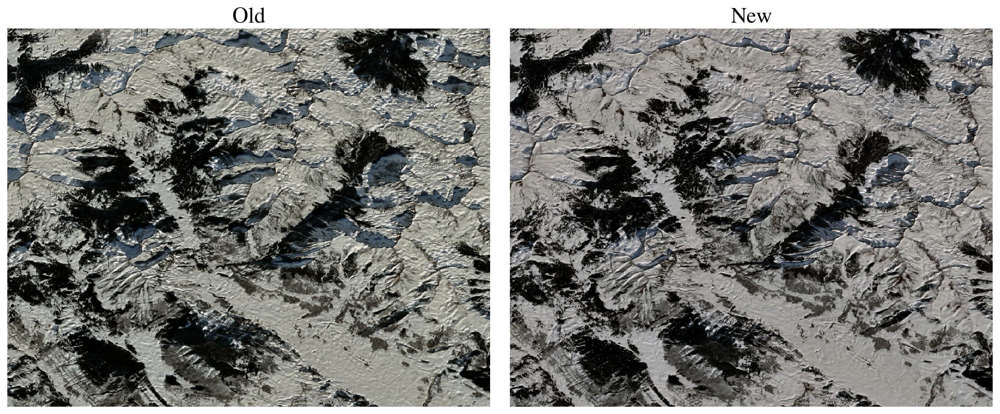

In [11]:
fig, axes = plt.subplots(ncols=2, figsize=(14, 6))

# R,G,B = B04,B03,B02
img = harmonized.sel(band=["B04", "B03", "B02"]).astype("float32").compute()

# # Option A: Robust per-band limits over all times (2–98th percentiles), NaNs ignored
# # Method 1: percentiles
# vmin = img.quantile(0.02, dim=("time","y","x"), skipna=True)   # dims: band
# vmax = img.quantile(0.98, dim=("time","y","x"), skipna=True)

# Method 2: If you prefer exact min/max instead of percentiles
vmin = img.min(dim=("time","y","x"), skipna=True)
vmax = img.max(dim=("time","y","x"), skipna=True)


# Rescale to 0–1; NaNs stay NaN (transparent in plot)
img_s = ((img - vmin) / (vmax - vmin)).clip(0, 1)

# Plot two dates
img0 = img_s.isel(time=0)
img1 = img_s.isel(time=1)

if np.isfinite(img0.values).any():
    img0.plot.imshow(rgb="band", ax=axes[0])
    axes[0].set(title="Old")
else:
    axes[0].text(0.5, 0.5, "All NaN", ha="center", va="center"); axes[0].set(title="Old")

if np.isfinite(img1.values).any():
    img1.plot.imshow(rgb="band", ax=axes[1])
    axes[1].set(title="New")
else:
    axes[1].text(0.5, 0.5, "All NaN", ha="center", va="center"); axes[1].set(title="New")

for ax in axes:
    ax.set_axis_off()

plt.tight_layout(); plt.show()


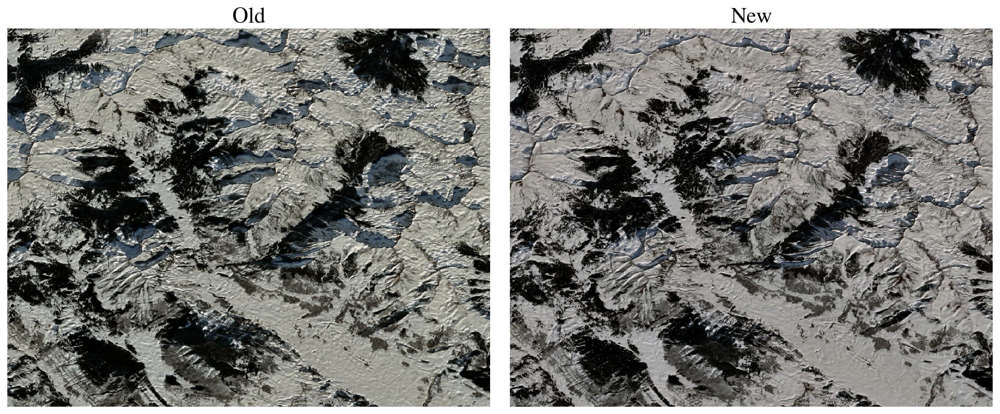

In [12]:
fig, axes = plt.subplots(ncols=2, figsize=(14, 6))

# R,G,B = B04,B03,B02
img = harmonized.sel(band=["B04", "B03", "B02"]).astype("float32").compute()


# # Option B: robust per-time, per-band limits
# # Method 1: percentiles
# vmin_tb = img.quantile(0.02, dim=("y","x"), skipna=True)  # dims: time, band
# vmax_tb = img.quantile(0.98, dim=("y","x"), skipna=True)

# # Method 2: If you prefer exact min/max instead of percentiles
vmin_tb = img.min(dim=("time","y","x"), skipna=True)
vmax_tb = img.max(dim=("time","y","x"), skipna=True)


# Rescale to 0–1; NaNs stay NaN (transparent in plot)
img_s = ((img - vmin_tb) / (vmax_tb - vmin_tb)).clip(0, 1)

# Plot two dates
img0 = img_s.isel(time=0)
img1 = img_s.isel(time=1)

if np.isfinite(img0.values).any():
    img0.plot.imshow(rgb="band", ax=axes[0])
    axes[0].set(title="Old")
else:
    axes[0].text(0.5, 0.5, "All NaN", ha="center", va="center"); axes[0].set(title="Old")

if np.isfinite(img1.values).any():
    img1.plot.imshow(rgb="band", ax=axes[1])
    axes[1].set(title="New")
else:
    axes[1].text(0.5, 0.5, "All NaN", ha="center", va="center"); axes[1].set(title="New")

for ax in axes:
    ax.set_axis_off()

plt.tight_layout(); plt.show()


And the histograms now mostly overlap. Any remaining differences are a result of the two scenes being captured a year apart.

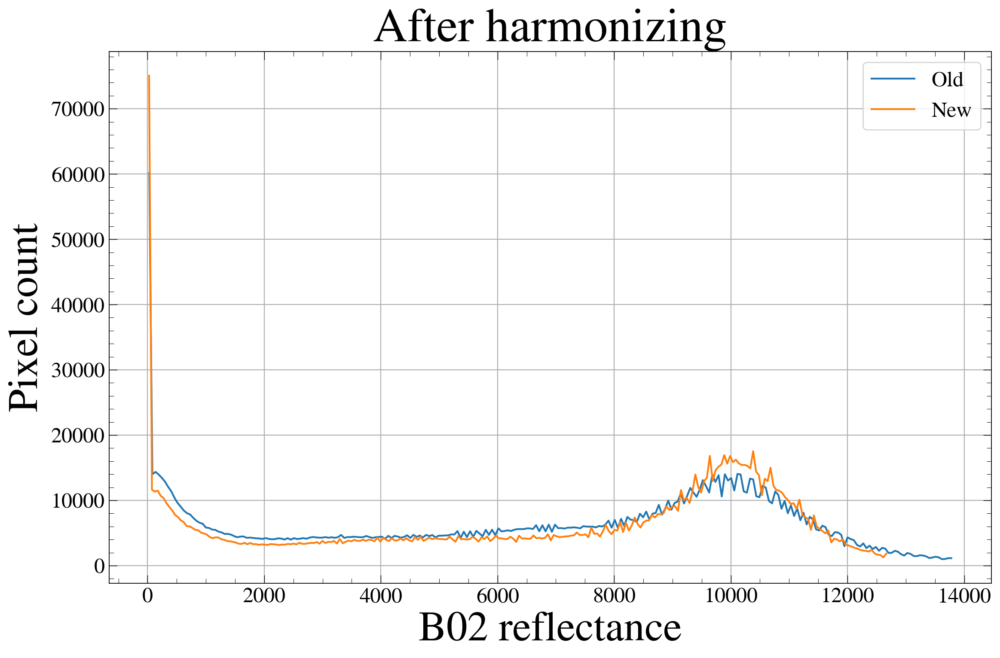

In [13]:
def plot_hist(ax, da, label, nbins=256, q=(2, 98)):
    """Histogram of an xarray DataArray, ignoring NaNs with robust range."""
    # Load to NumPy and drop NaNs
    vals = da.load().values
    vals = vals[np.isfinite(vals)]
    if vals.size == 0:
        ax.text(0.5, 0.5, f"{label}: all NaN", ha="center", va="center", transform=ax.transAxes)
        return
    # Robust limits from percentiles, fallback to min/max if needed
    lo, hi = np.percentile(vals, [q[0], q[1]]) if q else (np.nanmin(vals), np.nanmax(vals))
    if not np.isfinite(lo) or not np.isfinite(hi) or lo == hi:
        lo, hi = np.nanmin(vals), np.nanmax(vals)
    hist, edges = np.histogram(vals, bins=nbins, range=(lo, hi))
    centers = 0.5 * (edges[:-1] + edges[1:])
    ax.plot(centers, hist, label=label)

# Pick a band by NAME to avoid off-by-one issues (e.g., B03 = green)
# band_name = "B03"  # change as needed

fig, ax = plt.subplots(figsize=(12, 8))
plot_hist(ax, harmonized.sel(time=harmonized.time[0], band=band_name), "Old")
plot_hist(ax, harmonized.sel(time=harmonized.time[1], band=band_name), "New")
ax.set_xlabel(f"{band_name} reflectance", fontsize=35)
ax.set_ylabel("Pixel count", fontsize=35)
# ax.set_title(f"Histogram of {band_name}")
ax.set_title(f"After harmonizing", fontsize=40)
ax.legend()
# sns.despine()
plt.tight_layout(); plt.show()

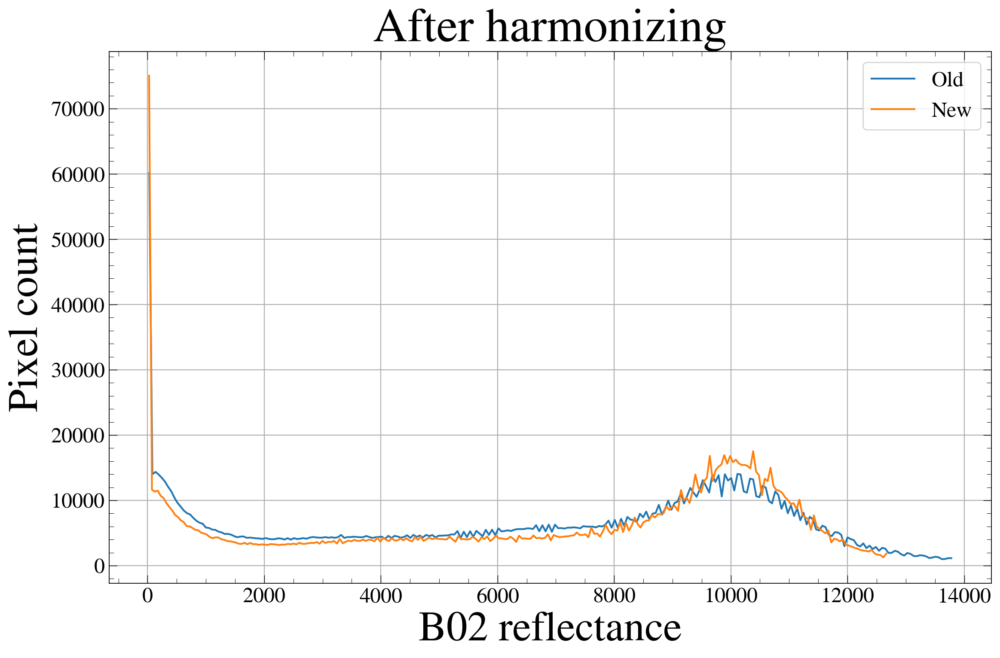

In [14]:
# band_name = "B03"  

fig, ax = plt.subplots(figsize=(12, 8))

def plot_skimage_hist(ax, da, label, nbins=256, q=(2, 98)):
    vals = da.load().values
    vals = vals[np.isfinite(vals)]
    if vals.size == 0:
        ax.text(0.5, 0.5, f"{label}: all NaN", ha="center", va="center", transform=ax.transAxes)
        return
    # optional robust clipping to avoid extreme outliers
    if q is not None:
        lo, hi = np.percentile(vals, q)
        vals = vals[(vals >= lo) & (vals <= hi)]
    hist, bin_centers = exposure.histogram(vals, nbins=nbins, source_range="image", channel_axis=None)
    ax.plot(bin_centers, hist, label=label)

plot_skimage_hist(ax, harmonized.sel(time=harmonized.time[0], band=band_name), "Old")
plot_skimage_hist(ax, harmonized.sel(time=harmonized.time[1], band=band_name), "New")

ax.set_xlabel(f"{band_name} reflectance", fontsize=35)
ax.set_ylabel("Pixel count", fontsize=35)
# ax.set_title(f"Histogram of {band_name}")
ax.set_title(f"After harmonizing", fontsize=40)
ax.legend()
plt.tight_layout(); plt.show()

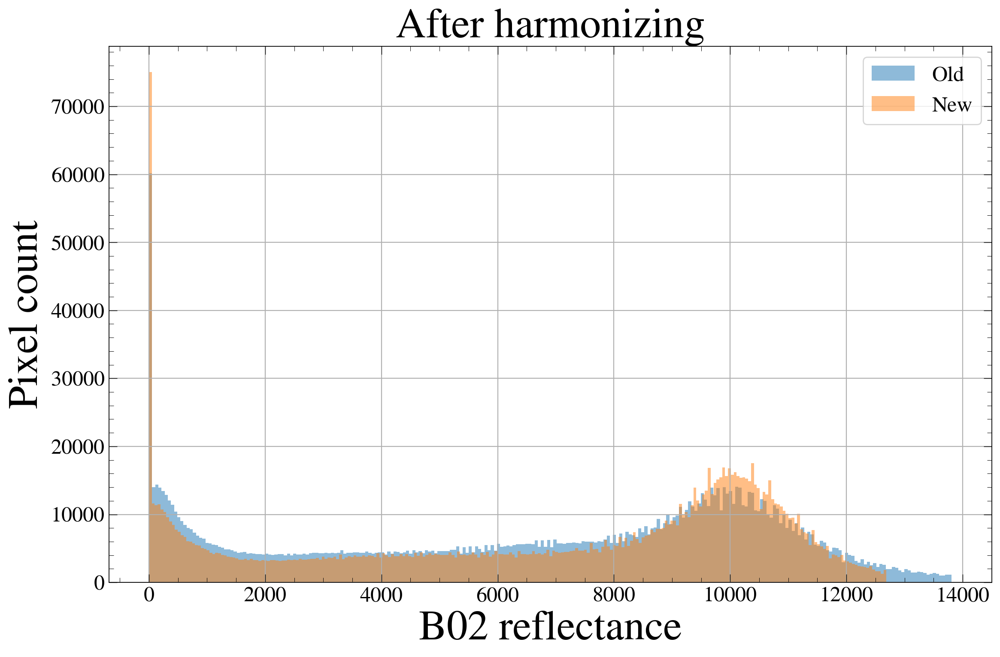

In [15]:
def finite_vals(da, clip_q=(2,98)):
    v = da.load().values
    v = v[np.isfinite(v)]
    if v.size == 0:
        return v
    if clip_q:
        lo, hi = np.percentile(v, clip_q)
        v = v[(v>=lo) & (v<=hi)]
    return v

# band_name = "B03"
vals_old = finite_vals(harmonized.sel(time=harmonized.time[0], band=band_name))
vals_new = finite_vals(harmonized.sel(time=harmonized.time[1], band=band_name))

fig, ax = plt.subplots(figsize=(12,8))

if vals_old.size:
    h1, c1 = exposure.histogram(vals_old, nbins=256, source_range="image", channel_axis=None)
    ax.bar(c1, h1, width=(c1[1]-c1[0]) if len(c1)>1 else 1.0, alpha=0.5, label="Old")

if vals_new.size:
    h2, c2 = exposure.histogram(vals_new, nbins=256, source_range="image", channel_axis=None)
    ax.bar(c2, h2, width=(c2[1]-c2[0]) if len(c2)>1 else 1.0, alpha=0.5, label="New")

ax.set_xlabel(f"{band_name} reflectance", fontsize=35); 
ax.set_ylabel("Pixel count", fontsize=35)
# ax.set_title(f"Histogram of {band_name}")
ax.set_title(f"After harmonizing", fontsize=35)
ax.legend(); plt.tight_layout(); plt.show()
